In [1]:
import numpy as np
import glob
import matplotlib.pyplot as plt
import cv2
from skimage import color, morphology, segmentation, io
from skimage.exposure import histogram
from skimage.util import img_as_ubyte
from PIL import Image
import tifffile as tiff
import Utils as h
import skimage

In [1]:
images = [
    cv2.imread(file)
    for file in glob.glob(r"C:\Users\mlnot\Desktop\Images\downsaples\ADAM9/*.png")
]
H, E, DAB = h.ihc_stain_separation(images[0])

fig, ax_arr = plt.subplots(2, 2, sharex=True, sharey=True, figsize=(10, 10))
ax1, ax2, ax3, ax4 = ax_arr.ravel()

ax1.imshow(images[0])
ax1.set_title("Original Image as gray")

ax2.imshow(H)
ax2.set_title("Hematoxylin")

ax3.imshow(E)
ax3.set_title("Eosin")

ax4.imshow(DAB)
ax4.set_title("DAB")

for ax in ax_arr.ravel():
    ax.set_axis_off()

plt.tight_layout()
plt.show

NameError: name 'glob' is not defined

In [2]:
im = cv2.imread(r"C:\Users\mlnot\Desktop\Images\test1.png", 0)
cv2.imshow("image", im)

cv2.waitKey(0)
cv2.destroyAllWindows()
# cv2.imwrite(r"C:\Users\mlnot\Desktop\Images\test1gray.png",im)

<function matplotlib.pyplot.show(close=None, block=None)>

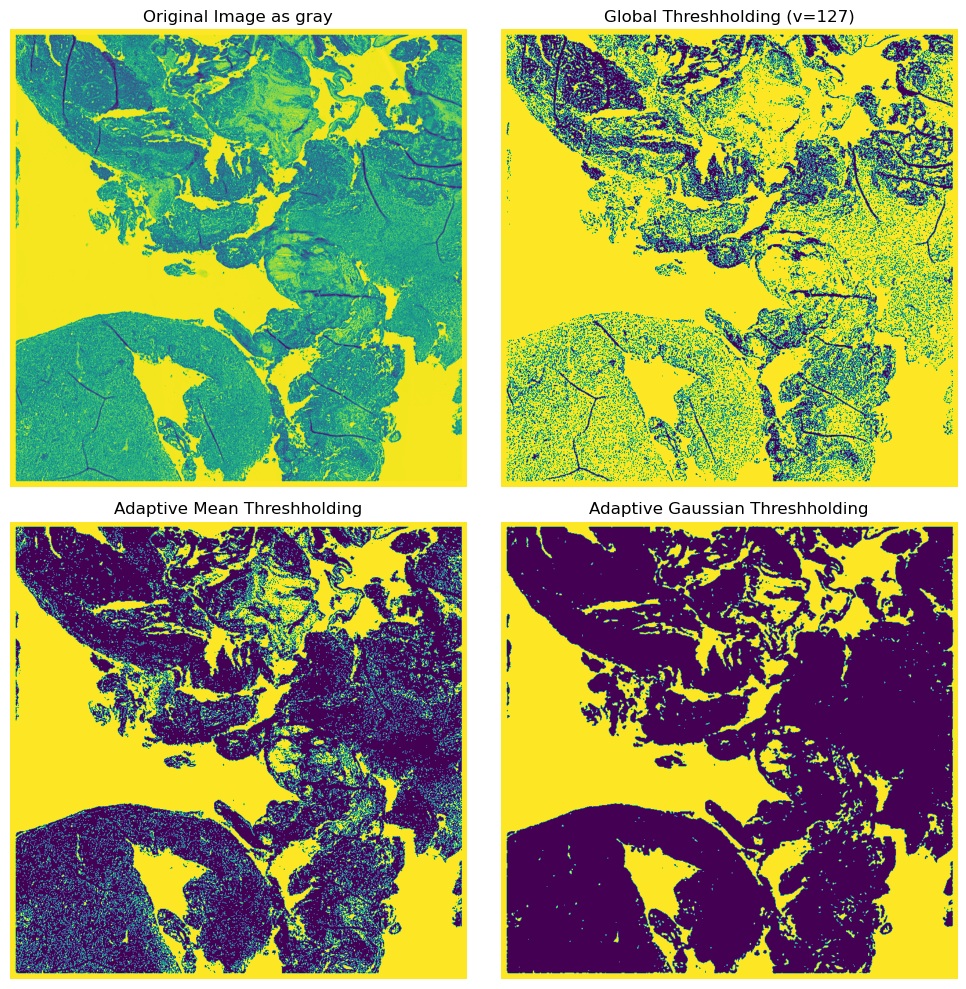

In [46]:
img = cv2.imread(r"C:\Users\mlnot\Desktop\Images\test1gray.png", cv2.IMREAD_GRAYSCALE)
cv2.imshow("image", img)
cv2.waitKey(0)
cv2.destroyAllWindows()
ret, th1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
ret2, th2 = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
blur = cv2.GaussianBlur(img, (5, 5), 0)
ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

fig, ax_arr = plt.subplots(2, 2, sharex=True, sharey=True, figsize=(10, 10))
ax1, ax2, ax3, ax4 = ax_arr.ravel()

ax1.imshow(img)
ax1.set_title("Original Image as gray")

ax2.imshow(th1)
ax2.set_title("Global Threshholding (v=127)")

ax3.imshow(th2)
ax3.set_title("Adaptive Mean Threshholding")

ax4.imshow(th3)
ax4.set_title("Adaptive Gaussian Threshholding")

for ax in ax_arr.ravel():
    ax.set_axis_off()

plt.tight_layout()
plt.show

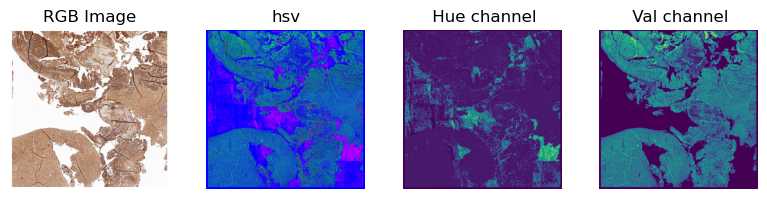

In [2]:
import skimage

image1 = skimage.io.imread(r"C:\Users\mlnot\Desktop\Images\test1.png")
image = color.rgba2rgb(image1)
hsv_img = color.rgb2hsv(image)
hue_img = hsv_img[:, :, 0]
sat_img = hsv_img[:, :, 1]
val_img = hsv_img[:, :, 2]

fig, (ax0, ax1, ax2, ax3) = plt.subplots(ncols=4, figsize=(8, 2))
ax0.imshow(image)
ax0.set_title("RGB Image")
ax0.axis("off")
ax1.imshow(hsv_img)
ax1.set_title("hsv")
ax1.axis("off")
ax2.imshow(hue_img)
ax2.set_title(" Hue channel")
ax2.axis("off")
ax3.imshow(sat_img)
ax3.set_title(" Val channel")
ax3.axis("off")


# convert to hsv
# hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
# mask = cv2.inRange(hsv,(0,0,180),(180,70,255))
# mask = cv2.inRange(hsv,(0,30,0),(20,90,31)) #white
fig.tight_layout()

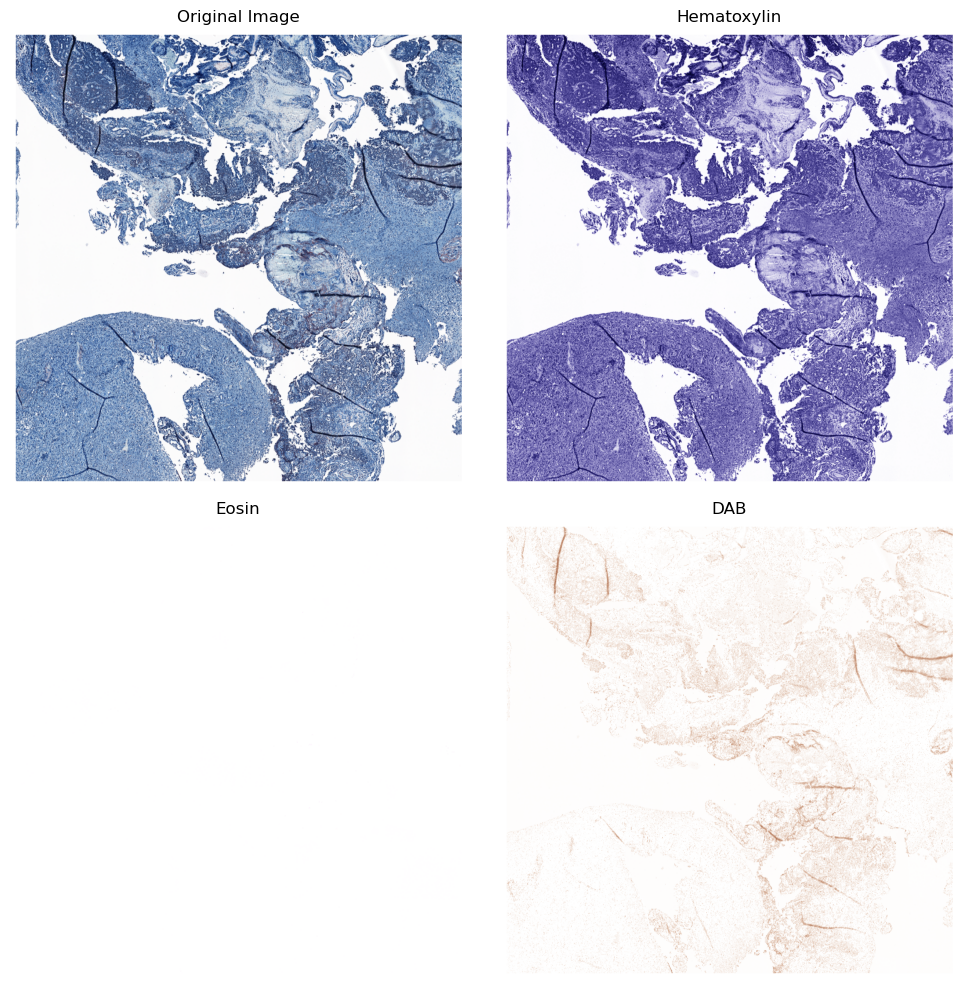

In [3]:
image = cv2.imread(r"C:\Users\mlnot\Desktop\Images\test1.png")
d,h,e = h.ihc_stain_separation(image, hematoxylin=True, eosin=True)
fig, ax_arr = plt.subplots(2, 2, figsize=(10, 10))
ax1, ax2, ax3, ax4 = ax_arr.ravel()
ax1.imshow(image.astype(np.uint8))
ax1.set_title("Original Image")
ax2.imshow(h)
ax2.set_title("Hematoxylin")
ax3.imshow(e)
ax3.set_title("Eosin")
ax4.imshow(d)
ax4.set_title("DAB")
for ax in ax_arr.ravel():
    ax.set_axis_off()
plt.tight_layout()

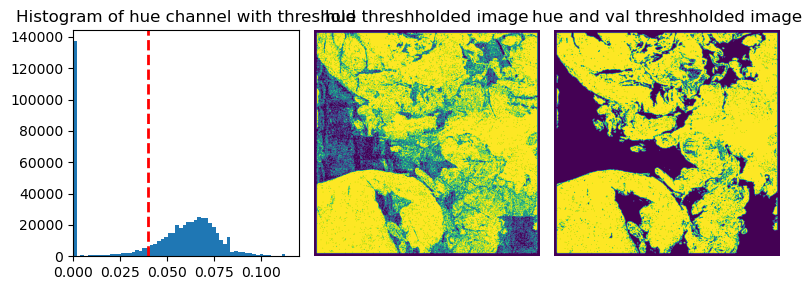

In [4]:
##thresholding
hue_threshold = 0.04
val_threshold = 0.1
sat_threshold = 0.1
bin_img1 = sat_img > sat_threshold
bin_img = hue_img > hue_threshold
bin_img2 = (hue_img > hue_threshold) | (val_img < val_threshold)

fig, (ax0, ax1, ax2) = plt.subplots(ncols=3, figsize=(8, 3))
ax0.hist(hue_img.ravel(), 512)
ax0.set_title("Histogram of hue channel with threshold")
ax0.axvline(x=hue_threshold, color="r", linestyle="dashed", linewidth=2)
ax0.set_xbound(0, 0.12)
ax1.imshow(bin_img)
ax1.set_title("hue threshholded image")
ax1.axis("off")
ax2.imshow(bin_img1)
ax2.set_title("hue and val threshholded image")
ax2.axis("off")
fig.tight_layout()

(-0.5, 787.5, 789.5, -0.5)

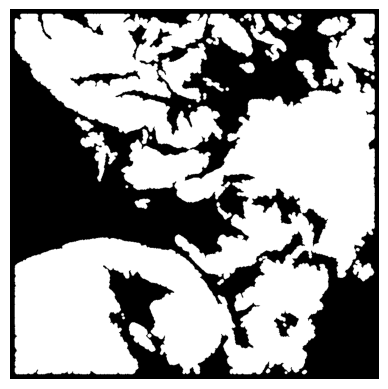

In [4]:
he = cv2.imread(r"C:\Users\mlnot\Desktop\Images\test1.png")
lum = color.rgb2gray(image)
mask = morphology.remove_small_holes(
    morphology.remove_small_objects(lum < 0.7, 500), 500
)
mask = morphology.opening(mask, morphology.disk(3))
plt.imshow(mask, cmap="gray")
plt.axis("off")

NameError: name 'mask' is not defined

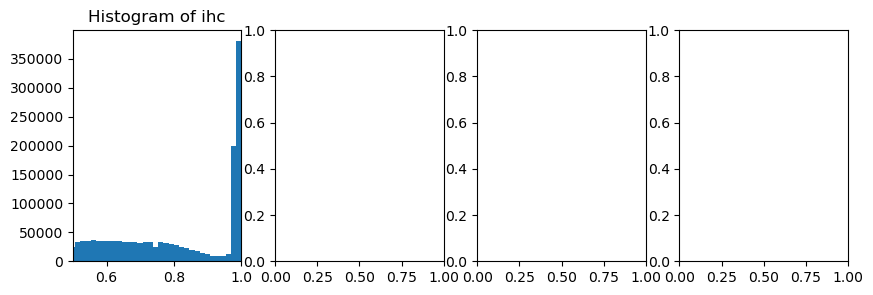

In [5]:
ihc = image
fig, (ax0, ax1, ax2, ax3) = plt.subplots(ncols=4, figsize=(10, 3))
ax0.hist(ihc.ravel(), 64)
ax0.set_title("Histogram of ihc")
ax0.set_xbound(0.5, 1)
# ax0.axvline(x=hue_threshold, color='r',linestyle = 'dashed',linewidth=2)
# ax0.set_xbound(0,0.12)
ax1.imshow(mask)
ax1.set_title("Mask")
ax1.axis("off")
ax2.imshow(ihc)
ax2.set_title("image")
ax2.axis("off")
ax3.hist(hue_img.ravel(), 512)
ax3.axvline(x=hue_threshold, color="r", linestyle="dashed", linewidth=2)
ax3.set_xbound(0, 0.12)
fig.tight_layout()

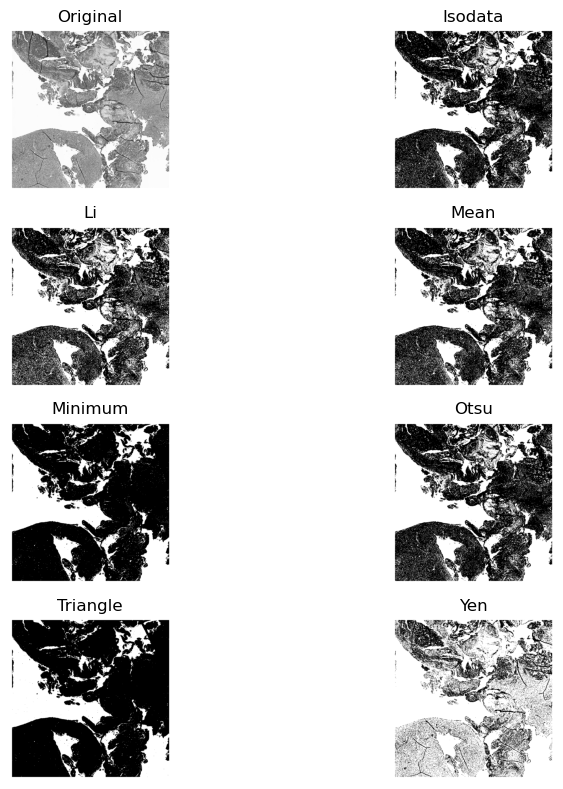

In [6]:
from skimage.filters import try_all_threshold

ihc_gray = cv2.imread(
    r"C:\Users\mlnot\Desktop\Images\test1gray.png", cv2.IMREAD_GRAYSCALE
)
fig, ax = try_all_threshold(ihc_gray, figsize=(10, 8), verbose=False)
plt.show()

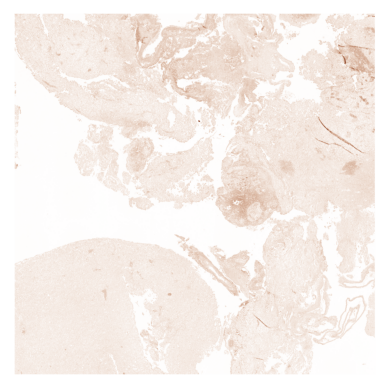

In [24]:
H, E, DAB = h.ihc_stain_separation(image)
plt.imshow(DAB)
plt.axis("off")
dab_gray = color.rgb2gray(DAB)
# plt.imshow(dab_gray)

In [25]:
cols, rows = dab_gray.shape
sat_values = []
for row in range(rows):
    for col in range(cols):
        if mask[col, row] == True and sat_img[col, row] >= 0.1:
            sat_values = np.append(sat_values, sat_img[col, row])

print(sat_values)

[0.57594937 0.53846154 0.6618705  ... 0.60571429 0.375      0.4       ]


In [26]:
print("size", sat_values.size)
print("mean", sat_values.mean())
print("std ", sat_values.std())
print("min ", sat_values.min())
print("max ", sat_values.max())

size 317269
mean 0.542159534805494
std  0.165708171778616
min  0.1
max  0.9841269841269842


In [19]:
print("size", sat_values.size)
print("mean", sat_values.mean())
print("std ", sat_values.std())
print("min ", sat_values.min())
print("max ", sat_values.max())

size 343034
mean 0.38886457017756054
std  0.13774619966937715
min  0.1
max  0.8947368421052632


Text(0.5, 1.0, 'Gray-level histogram')

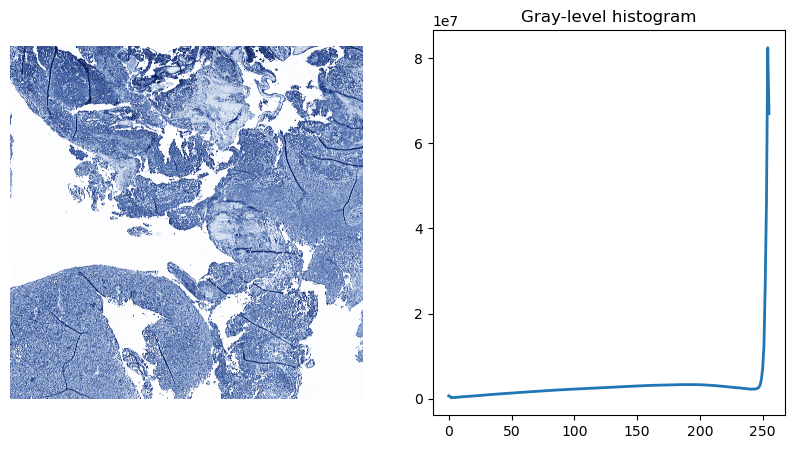

In [15]:
img1 = cv2.imread(r"C:\Users\mlnot\Desktop\Images\DAB_img.png")
img1 = img_as_ubyte(img1)
hist, hist_centers = histogram(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")

Text(0.5, 1.0, 'Gray-level histogram')

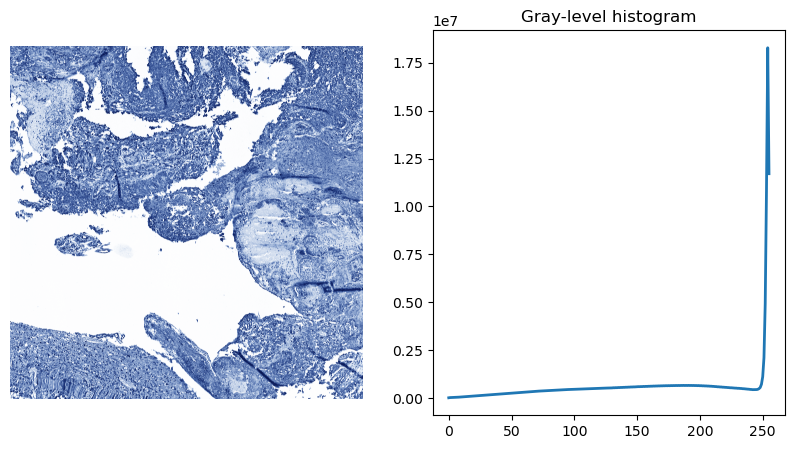

In [5]:
img1 = cv2.imread(r"C:\Users\mlnot\Desktop\Images\DAB_img_z1.png")
img1 = img_as_ubyte(img1)
hist, hist_centers = histogram(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")

Text(0.5, 1.0, 'Gray-level histogram')

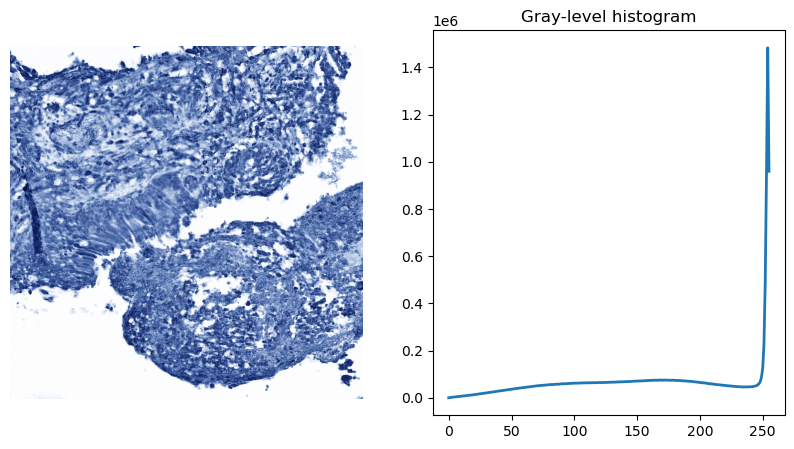

In [6]:
img1 = cv2.imread(r"C:\Users\mlnot\Desktop\Images\DAB_img_z2.png")
img1 = img_as_ubyte(img1)
hist, hist_centers = histogram(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")

(256,)


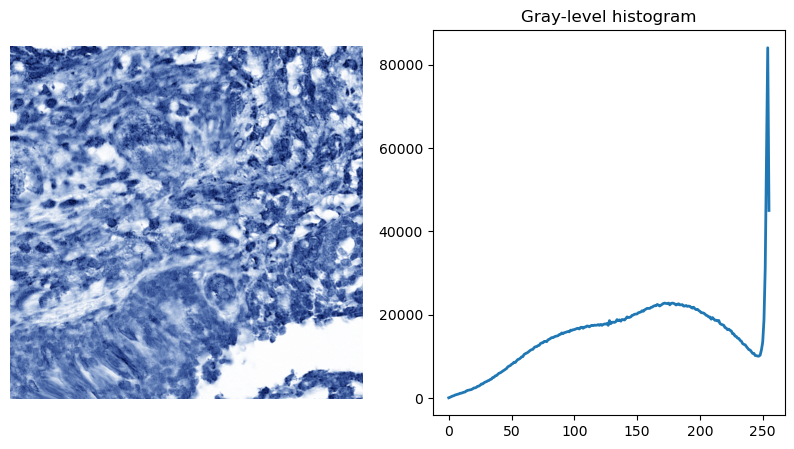

In [3]:
img1 = cv2.imread(r"C:\Users\mlnot\Desktop\Images\DAB_img_z3.png")
img1 = img_as_ubyte(img1)
hist, hist_centers = histogram(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")
print(hist.shape)

(256,)


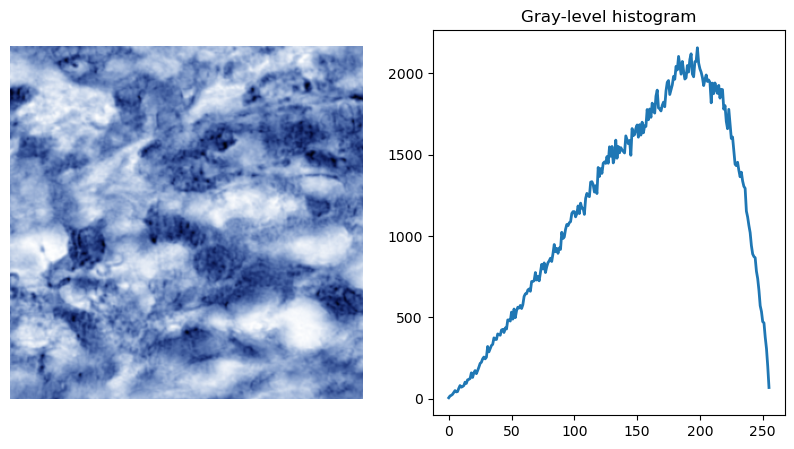

In [3]:
img1 = cv2.imread(r"C:\Users\mlnot\Desktop\Images\DAB_img_z4.png")
img1 = img_as_ubyte(img1)
hist, hist_centers = histogram(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")
print(hist.shape)

c:\Users\mlnot\anaconda3\envs\DoctorThesis\Lib\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


(256,)


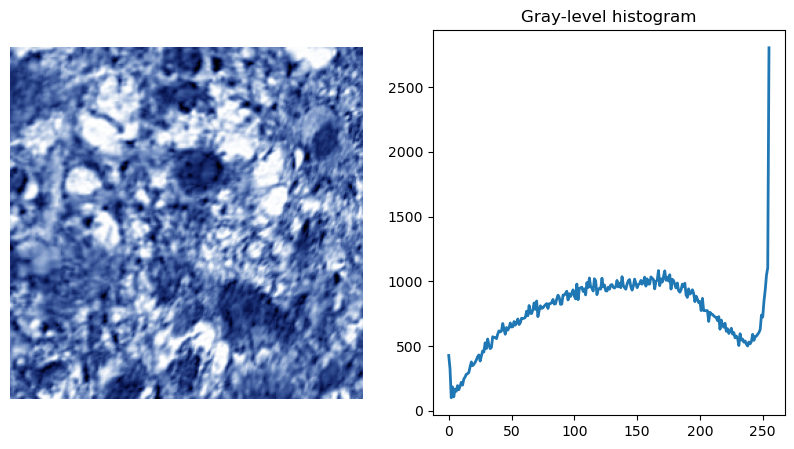

In [22]:
img1 = cv2.imread(
    r"C:\Users\mlnot\Desktop\Images\saved _tiles\N_2014_000862\ADAM9\DAB_tiles\9_336_DAB.tif"
)
img1 = img_as_ubyte(img1)
hist, hist_centers = histogram(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")
print(hist.shape)

100%|██████████| 256/256 [00:00<00:00, 1220.64it/s]


Pixel Count: 61211
Number Pixel in Zone  1 :  37624.0
Percentage of Contribution to Zone  1 :  61.466076358824395 %
Score calculation for Zone  1 :  2.458643054352976
Number Pixel in Zone  2 :  23587.0
Percentage of Contribution to Zone  2 :  38.533923641175605 %
Score calculation for Zone  2 :  1.1560177092352681
Number Pixel in Zone  3 :  0.0
Percentage of Contribution to Zone  3 :  0.0 %
Score calculation for Zone  3 :  0.0
Number Pixel in Zone  4 :  0.0
Percentage of Contribution to Zone  4 :  0.0 %
Score calculation for Zone  4 :  0.0


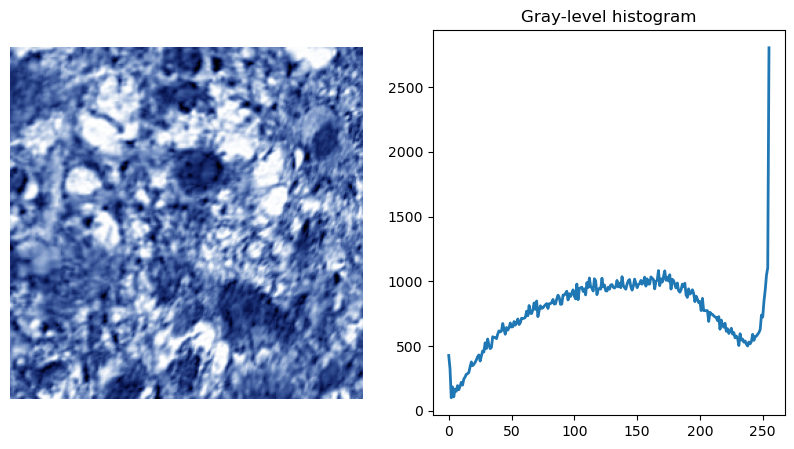

In [23]:
hist, hist_centers, zones, percentage, score, count = h.calculate_pixel_intensity(img1)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img1)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")

print("Pixel Count:", count)
for i in range(4):
    print("Number Pixel in Zone ", i + 1, ": ", zones[i])
    print("Percentage of Contribution to Zone ", i + 1, ": ", percentage[i], "%")
    print("Score calculation for Zone ", i + 1, ": ", score[i])

(256,)


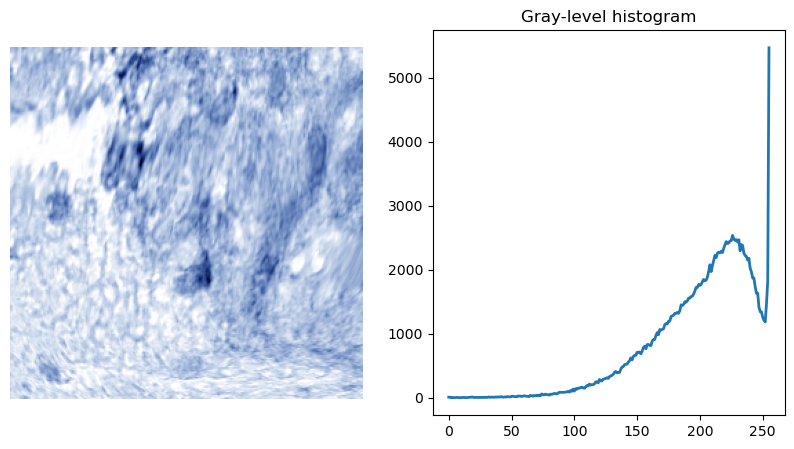

In [4]:
img2 = cv2.imread(
    r"C:\Users\mlnot\Desktop\Images\saved _tiles\N_2014_000862\ADAM9\DAB_tiles\5_380_DAB.tif"
)
img2 = img_as_ubyte(img2)
hist, hist_centers = histogram(img2)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img2)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")
print(hist.shape)

(238,)


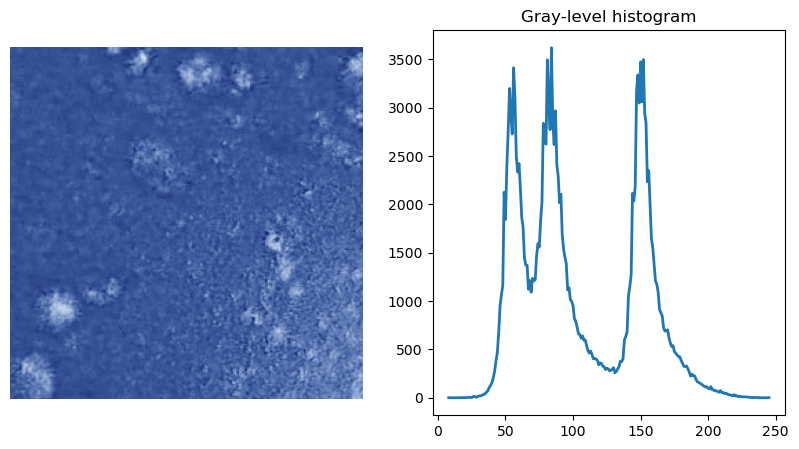

In [10]:
img3 = cv2.imread(
    r"C:\Users\mlnot\Desktop\Images\saved _tiles\N_2014_000862\ADAM9\DAB_tiles\5_544_DAB.tif"
)
img3 = img_as_ubyte(img3)
hist, hist_centers = histogram(img3)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(img3)
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")
print(hist.shape)

In [11]:
gray = color.rgb2gray(img1)
gray_ubyte = img_as_ubyte(gray)
gray2 = color.rgb2gray(img2)
gray_ubyte2 = img_as_ubyte(gray2)
gray3 = color.rgb2gray(img3)
gray_ubyte3 = img_as_ubyte(gray3)

In [12]:
h, w = gray_ubyte.shape
print(gray_ubyte.shape)
z = np.zeros(4)

count = 0
for y in range(h):
    for x in range(w):
        if gray_ubyte[x, y] < 60:
            z[0] += 1
            count += 1
        elif gray_ubyte[x, y] >= 61 and gray_ubyte[x, y] < 120:
            z[1] += 1
            count += 1
        elif gray_ubyte[x, y] >= 121 and gray_ubyte[x, y] < 180:
            z[2] += 1
            count += 1
        elif gray_ubyte[x, y] >= 181 and gray_ubyte[x, y] < 235:
            z[3] += 1
            count += 1
        else:
            count += 1

print("z", z, "count", count)


def score_calc(z, count):
    score = np.zeros(shape=4)
    percentage = np.zeros(shape=4)
    for i in range(z.size):
        score[i] = ((z.size - i) * z[i]) / count
        percentage[i] = z[i] / count
    return score, percentage


score, percentage = score_calc(z, count)
print("Score Zone 1:", score[0])
print("Score Zone 2:", score[1])
print("Score Zone 3:", score[2])
print("Score Zone 4:", score[3])
print("Percentage Contribution of high positive: ", percentage[0])
print("Percentage Contribution of positive: ", percentage[1])
print("Percentage Contribution of low positive: ", percentage[2])
print("Percentage Contribution of negative: ", percentage[3])
print(score, "%")
print(count)

(256, 256)
z [ 8671. 23158. 19162.  9088.] count 65536
Score Zone 1: 0.52923583984375
Score Zone 2: 1.060089111328125
Score Zone 3: 0.58477783203125
Score Zone 4: 0.138671875
Percentage Contribution of high positive:  0.1323089599609375
Percentage Contribution of positive:  0.353363037109375
Percentage Contribution of low positive:  0.292388916015625
Percentage Contribution of negative:  0.138671875
[0.52923584 1.06008911 0.58477783 0.13867188] %
65536


In [24]:
h, w = gray_ubyte2.shape
print(gray_ubyte2.shape)
z = np.zeros(4)

count = 0
for y in range(h):
    for x in range(w):
        if gray_ubyte2[x, y] < 60:
            z[0] += 1
            count += 1
        elif gray_ubyte2[x, y] >= 61 and gray_ubyte2[x, y] < 120:
            z[1] += 1
            count += 1
        elif gray_ubyte2[x, y] >= 121 and gray_ubyte2[x, y] < 180:
            z[2] += 1
            count += 1
        elif gray_ubyte2[x, y] >= 181 and gray_ubyte2[x, y] < 235:
            z[3] += 1
            count += 1
        else:
            count += 1

print("z", z, "count", count)


def score_calc(z, count):
    score = np.zeros(shape=4)
    percentage = np.zeros(shape=4)
    for i in range(z.size):
        score[i] = ((z.size - i) * z[i]) / count
        percentage[i] = z[i] / count
    return score, percentage


score, percentage = score_calc(z, count)
print("Score Zone 1:", score[0])
print("Score Zone 2:", score[1])
print("Score Zone 3:", score[2])
print("Score Zone 4:", score[3])
print("Percentage Contribution of high positive: ", percentage[0])
print("Percentage Contribution of positive: ", percentage[1])
print("Percentage Contribution of low positive: ", percentage[2])
print("Percentage Contribution of negative: ", percentage[3])
print(score, "%")
print(count)

(256, 256)
z [  146.  1512. 16867. 37143.] count 65536
Score Zone 1: 0.0089111328125
Score Zone 2: 0.0692138671875
Score Zone 3: 0.514739990234375
Score Zone 4: 0.5667572021484375
Percentage Contribution of high positive:  0.002227783203125
Percentage Contribution of positive:  0.0230712890625
Percentage Contribution of low positive:  0.2573699951171875
Percentage Contribution of negative:  0.5667572021484375
[0.00891113 0.06921387 0.51473999 0.5667572 ] %
65536


In [27]:
h, w = gray_ubyte3.shape
print(gray_ubyte3.shape)
z = np.zeros(4)

count = 0
for y in range(h):
    for x in range(w):
        if gray_ubyte3[x, y] < 60:
            z[0] += 1
            count += 1
        elif gray_ubyte3[x, y] >= 61 and gray_ubyte3[x, y] < 120:
            z[1] += 1
            count += 1
        elif gray_ubyte3[x, y] >= 121 and gray_ubyte3[x, y] < 180:
            z[2] += 1
            count += 1
        elif gray_ubyte3[x, y] >= 181 and gray_ubyte3[x, y] < 235:
            z[3] += 1
            count += 1
        else:
            count += 1

print("z", z, "count", count)


def score_calc(z, count):
    score = np.zeros(shape=4)
    percentage = np.zeros(shape=4)
    for i in range(z.size):
        score[i] = ((z.size - i) * z[i]) / count
        percentage[i] = z[i] / count
    return score, percentage


score, percentage = score_calc(z, count)
print("Score Zone 1:", score[0])
print("Score Zone 2:", score[1])
print("Score Zone 3:", score[2])
print("Score Zone 4:", score[3])
print("Percentage Contribution of high positive: ", percentage[0])
print("Percentage Contribution of positive: ", percentage[1])
print("Percentage Contribution of low positive: ", percentage[2])
print("Percentage Contribution of negative: ", percentage[3])

(256, 256)
z [  195. 59760.  5072.   203.] count 65536
Score Zone 1: 0.01190185546875
Score Zone 2: 2.735595703125
Score Zone 3: 0.15478515625
Score Zone 4: 0.0030975341796875
Percentage Contribution of high positive:  0.0029754638671875
Percentage Contribution of positive:  0.911865234375
Percentage Contribution of low positive:  0.077392578125
Percentage Contribution of negative:  0.0030975341796875
[0.01190186 2.7355957  0.15478516 0.00309753] %
65536


In [3]:
images = [
    io.imread(file)
    for file in glob.glob(
        r"C:\Users\mlnot\Desktop\Images\saved _tiles\for display/*.tif"
    )
]

hist_arr = []
hist_centers_arr = []
zones_arr = []
percentage_arr = []
score_arr = []
count_arr = []

for i in range(images.__len__()):
    (
        hist,
        hist_centers,
        zones,
        percentage,
        score,
        count,
        pos_px,
    ) = h.calculate_pixel_intensity(images[i])
    hist_arr.append(hist)
    hist_centers_arr.append(hist_centers)
    zones_arr.append(zones)
    percentage_arr.append(percentage)
    score_arr.append(score)
    count_arr.append(count)

c:\Users\mlnot\anaconda3\envs\DoctorThesis\Lib\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


TypeError: Cannot interpret '1024' as a data type

c:\Users\mlnot\anaconda3\envs\DoctorThesis\Lib\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)
  0%|          | 0/1024 [00:00<?, ?it/s]

100%|██████████| 1024/1024 [00:03<00:00, 335.20it/s]


Pixel Count: 1024392
Number Pixel in Zone  1 :  132466.0
Percentage of Contribution to Zone  1 :  12.931182594163172 %
Score calculation for Zone  1 :  0.5172473037665268
Number Pixel in Zone  2 :  451702.0
Percentage of Contribution to Zone  2 :  44.09464345680169 %
Score calculation for Zone  2 :  1.322839303704051
Number Pixel in Zone  3 :  320080.0
Percentage of Contribution to Zone  3 :  31.245851197588426 %
Score calculation for Zone  3 :  0.6249170239517685
Number Pixel in Zone  4 :  120144.0
Percentage of Contribution to Zone  4 :  11.728322751446711 %
Score calculation for Zone  4 :  0.11728322751446711


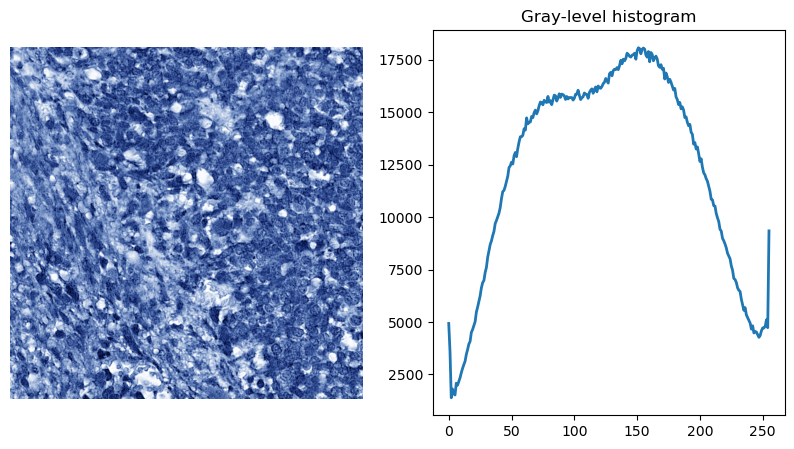

In [5]:
hist, hist_centers, zones, percentage, score, count = h.calculate_pixel_intensity(
    images[0]
)
fig, ax = plt.subplots(ncols=2, figsize=(10, 5))
ax[0].imshow(images[0])
ax[0].axis("off")
ax[1].plot(hist_centers, hist, lw=2)
ax[1].set_title("Gray-level histogram")

print("Pixel Count:", count)
for i in range(4):
    print("Number Pixel in Zone ", i + 1, ": ", zones[i])
    print("Percentage of Contribution to Zone ", i + 1, ": ", percentage[i], "%")
    print("Score calculation for Zone ", i + 1, ": ", score[i])

In [4]:
images_rgb = [
    cv2.imread(file)
    for file in glob.glob(
        r"C:\Users\mlnot\Desktop\Images\saved _tiles\for display/*.tif"
    )
]

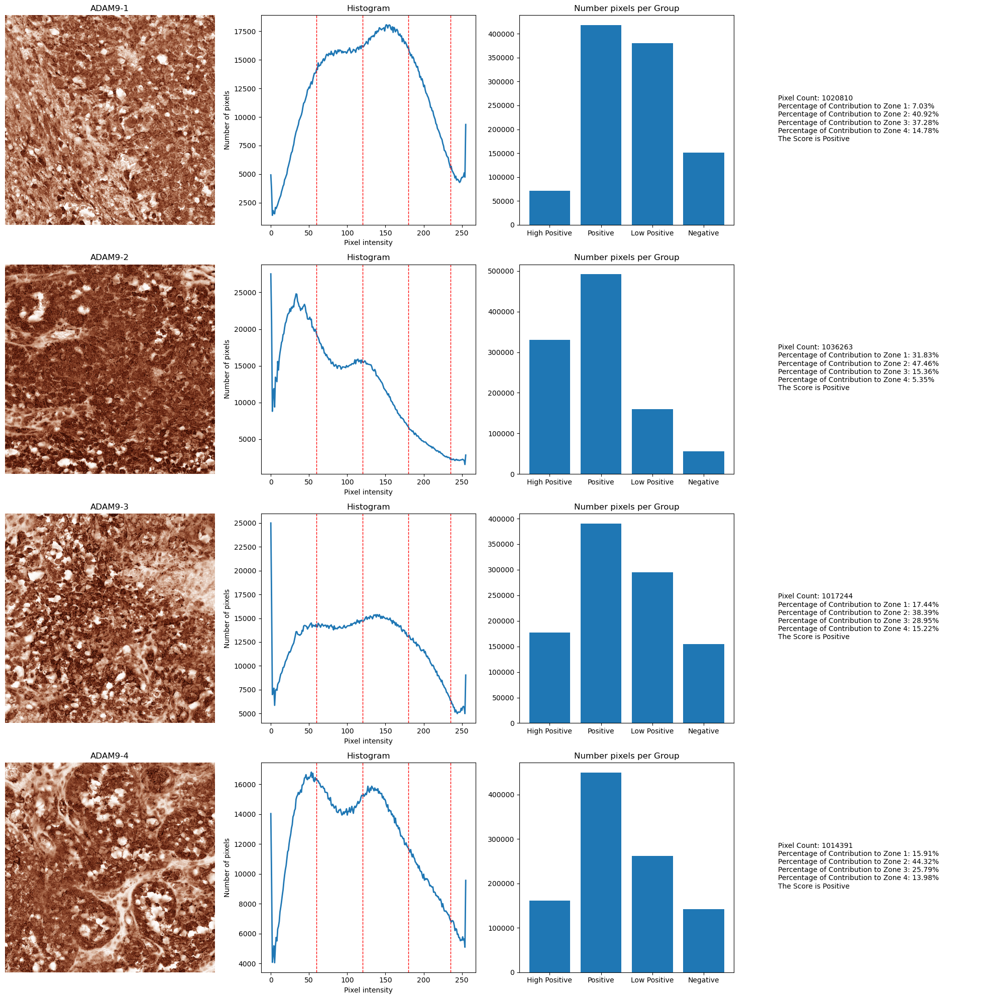

In [35]:
names = ["High Positive", "Positive", "Low Positive", "Negative"]
fig, ax = plt.subplots(4, 4, figsize=(20, 20))
ax[0][0].imshow(images[0])
ax[0][0].set_title("ADAM9-1")
ax[0][0].axis("off")
ax[0][1].plot(hist_centers_arr[0], hist_arr[0], lw=2)
ax[0][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[0][1].set_title("Histogram")
ax[0][1].set_ylabel("Number of pixels")
ax[0][1].set_xlabel("Pixel intensity")
ax[0][2].bar(names, zones_arr[0])
ax[0][2].set_title("Number pixels per Group")
ax[0][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[0])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[0][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[0][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[0][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[0][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[0][3].axis("off")

ax[1][0].imshow(images[1])
ax[1][0].set_title("ADAM9-2")
ax[1][0].axis("off")
ax[1][1].plot(hist_centers_arr[1], hist_arr[1], lw=2)
ax[1][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][1].set_title("Histogram")
ax[1][1].set_ylabel("Number of pixels")
ax[1][1].set_xlabel("Pixel intensity")
ax[1][2].bar(names, zones_arr[1])
ax[1][2].set_title("Number pixels per Group")
ax[1][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[1])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[1][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[1][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[1][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[1][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[1][3].axis("off")

ax[2][0].imshow(images[2])
ax[2][0].set_title("ADAM9-3")
ax[2][0].axis("off")
ax[2][1].plot(hist_centers_arr[2], hist_arr[2], lw=2)
ax[2][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[2][1].set_title("Histogram")
ax[2][1].set_ylabel("Number of pixels")
ax[2][1].set_xlabel("Pixel intensity")
ax[2][2].bar(names, zones_arr[2])
ax[2][2].set_title("Number pixels per Group")
ax[2][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[2])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[2][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[2][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[2][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[2][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[2][3].axis("off")

ax[3][0].imshow(images[3])
ax[3][0].set_title("ADAM9-4")
ax[3][0].axis("off")
ax[3][1].plot(hist_centers_arr[3], hist_arr[3], lw=2)
ax[3][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[3][1].set_title("Histogram")
ax[3][1].set_ylabel("Number of pixels")
ax[3][1].set_xlabel("Pixel intensity")
ax[3][2].bar(names, zones_arr[3])
ax[3][2].set_title("Number pixels per Group")
ax[3][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[3])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[3][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[3][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[3][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[3][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[3][3].axis("off")

fig.tight_layout()
plt.show()

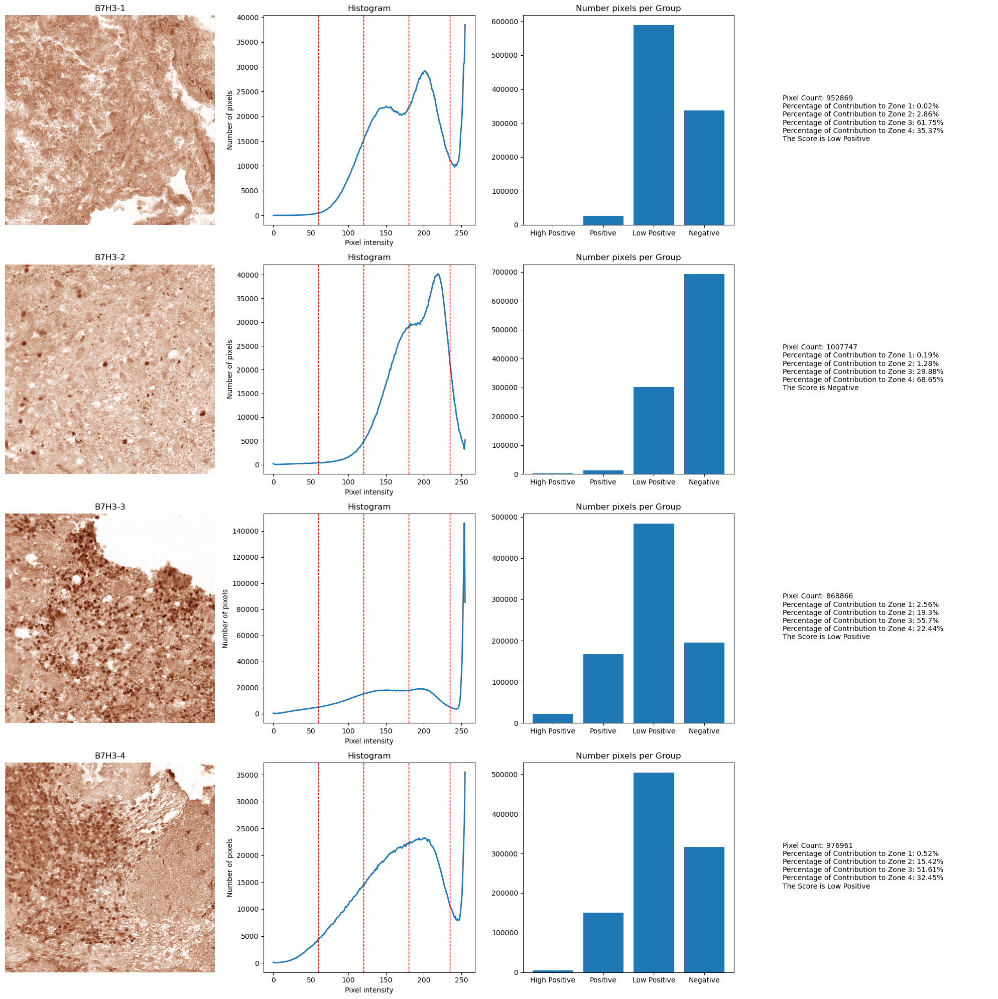

In [36]:
names = ["High Positive", "Positive", "Low Positive", "Negative"]
fig, ax = plt.subplots(4, 4, figsize=(20, 20))
ax[0][0].imshow(images[4])
ax[0][0].set_title("B7H3-1")
ax[0][0].axis("off")
ax[0][1].plot(hist_centers_arr[4], hist_arr[4], lw=2)
ax[0][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[0][1].set_title("Histogram")
ax[0][1].set_ylabel("Number of pixels")
ax[0][1].set_xlabel("Pixel intensity")
ax[0][2].bar(names, zones_arr[4])
ax[0][2].set_title("Number pixels per Group")
ax[0][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[4])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[4][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[4][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[4][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[4][3], 2))
    + "%\n"
    + "The Score is Low Positive",
)
ax[0][3].axis("off")

ax[1][0].imshow(images[5])
ax[1][0].set_title("B7H3-2")
ax[1][0].axis("off")
ax[1][1].plot(hist_centers_arr[5], hist_arr[5], lw=2)
ax[1][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][1].set_title("Histogram")
ax[1][1].set_ylabel("Number of pixels")
ax[1][1].set_xlabel("Pixel intensity")
ax[1][2].bar(names, zones_arr[5])
ax[1][2].set_title("Number pixels per Group")
ax[1][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[5])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[5][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[5][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[5][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[5][3], 2))
    + "%\n"
    + "The Score is Negative",
)
ax[1][3].axis("off")

ax[2][0].imshow(images[6])
ax[2][0].set_title("B7H3-3")
ax[2][0].axis("off")
ax[2][1].plot(hist_centers_arr[6], hist_arr[6], lw=2)
ax[2][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[2][1].set_title("Histogram")
ax[2][1].set_ylabel("Number of pixels")
ax[2][1].set_xlabel("Pixel intensity")
ax[2][2].bar(names, zones_arr[6])
ax[2][2].set_title("Number pixels per Group")
ax[2][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[6])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[6][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[6][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[6][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[6][3], 2))
    + "%\n"
    + "The Score is Low Positive",
)
ax[2][3].axis("off")

ax[3][0].imshow(images[7])
ax[3][0].set_title("B7H3-4")
ax[3][0].axis("off")
ax[3][1].plot(hist_centers_arr[7], hist_arr[7], lw=2)
ax[3][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[3][1].set_title("Histogram")
ax[3][1].set_ylabel("Number of pixels")
ax[3][1].set_xlabel("Pixel intensity")
ax[3][2].bar(names, zones_arr[7])
ax[3][2].set_title("Number pixels per Group")
ax[3][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[7])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[7][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[7][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[7][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[7][3], 2))
    + "%\n"
    + "The Score is Low Positive",
)
ax[3][3].axis("off")

fig.tight_layout()
plt.show()

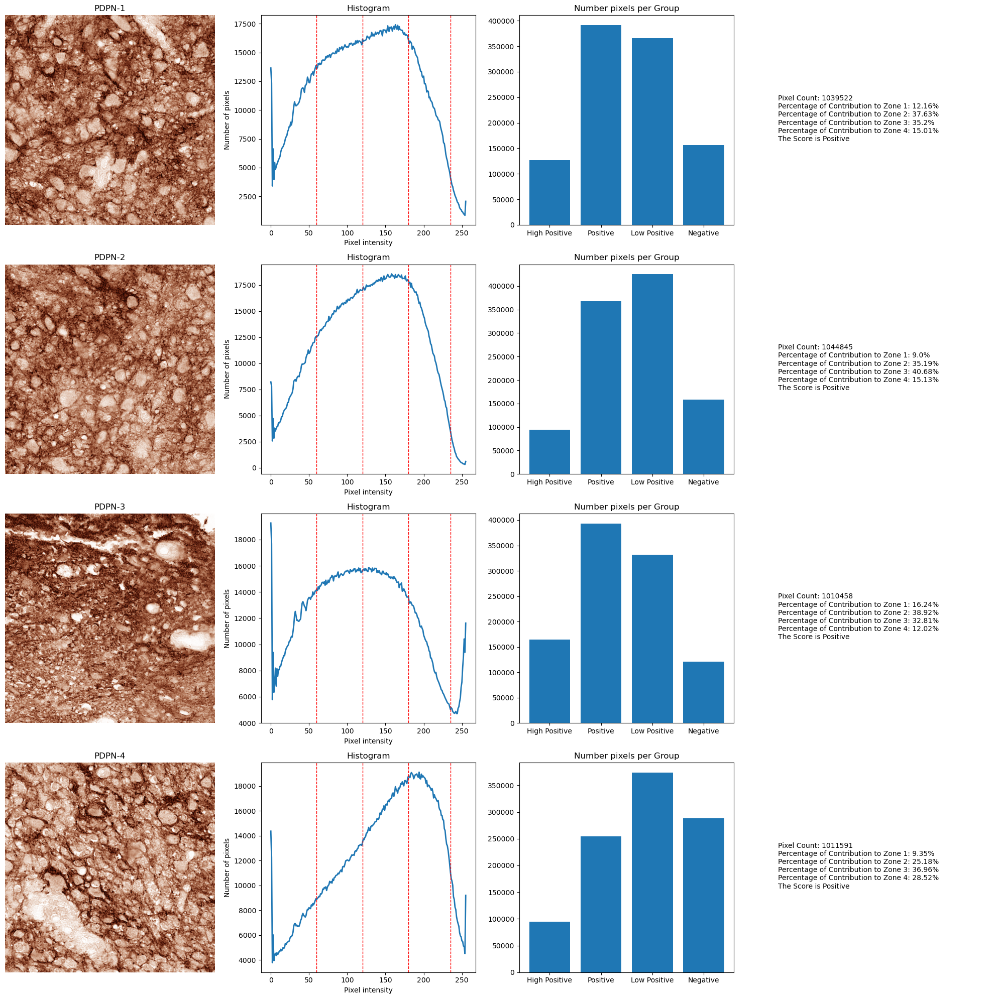

In [37]:
names = ["High Positive", "Positive", "Low Positive", "Negative"]
fig, ax = plt.subplots(4, 4, figsize=(20, 20))
ax[0][0].imshow(images[8])
ax[0][0].set_title("PDPN-1")
ax[0][0].axis("off")
ax[0][1].plot(hist_centers_arr[8], hist_arr[8], lw=2)
ax[0][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[0][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[0][1].set_title("Histogram")
ax[0][1].set_ylabel("Number of pixels")
ax[0][1].set_xlabel("Pixel intensity")
ax[0][2].bar(names, zones_arr[8])
ax[0][2].set_title("Number pixels per Group")
ax[0][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[8])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[8][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[8][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[8][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[8][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[0][3].axis("off")

ax[1][0].imshow(images[9])
ax[1][0].set_title("PDPN-2")
ax[1][0].axis("off")
ax[1][1].plot(hist_centers_arr[9], hist_arr[9], lw=2)
ax[1][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][1].set_title("Histogram")
ax[1][1].set_ylabel("Number of pixels")
ax[1][1].set_xlabel("Pixel intensity")
ax[1][2].bar(names, zones_arr[9])
ax[1][2].set_title("Number pixels per Group")
ax[1][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[9])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[9][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[9][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[9][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[9][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[1][3].axis("off")

ax[2][0].imshow(images[10])
ax[2][0].set_title("PDPN-3")
ax[2][0].axis("off")
ax[2][1].plot(hist_centers_arr[10], hist_arr[10], lw=2)
ax[2][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[2][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[2][1].set_title("Histogram")
ax[2][1].set_ylabel("Number of pixels")
ax[2][1].set_xlabel("Pixel intensity")
ax[2][2].bar(names, zones_arr[10])
ax[2][2].set_title("Number pixels per Group")
ax[2][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[10])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[10][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[10][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[10][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[10][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[2][3].axis("off")

ax[3][0].imshow(images[11])
ax[3][0].set_title("PDPN-4")
ax[3][0].axis("off")
ax[3][1].plot(hist_centers_arr[11], hist_arr[11], lw=2)
ax[3][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[3][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[3][1].set_title("Histogram")
ax[3][1].set_ylabel("Number of pixels")
ax[3][1].set_xlabel("Pixel intensity")
ax[3][2].bar(names, zones_arr[11])
ax[3][2].set_title("Number pixels per Group")
ax[3][3].text(
    0,
    0.4,
    "Pixel Count: "
    + str(count_arr[11])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[11][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[11][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[11][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[11][3], 2))
    + "%\n"
    + "The Score is Positive",
)
ax[3][3].axis("off")

fig.tight_layout()
plt.show()

In [81]:
images = [
    io.imread(file) for file in glob.glob(r"C:\Users\mlnot\Desktop\Images\29_86/*.tif")
]

In [82]:
hist_arr = []
hist_centers_arr = []
zones_arr = []
percentage_arr = []
score_arr = []
count_arr = []
pos_px_arr = []

for i in range(images.__len__()):
    (
        hist,
        hist_centers,
        zones,
        percentage,
        score,
        count,
        positive_px,
    ) = h.calculate_pixel_intensity(images[i])
    hist_arr.append(hist)
    hist_centers_arr.append(hist_centers)
    zones_arr.append(zones)
    percentage_arr.append(percentage)
    score_arr.append(score)
    count_arr.append(count)
    pos_px_arr.append(positive_px)


zones_arr = np.array(zones_arr)
percentage_arr = np.array(percentage_arr)
score_arr = np.array(score_arr)
count_arr = np.array(count_arr)
pos_px_arr = np.array(pos_px_arr)

c:\Users\mlnot\anaconda3\envs\DoctorThesis\Lib\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


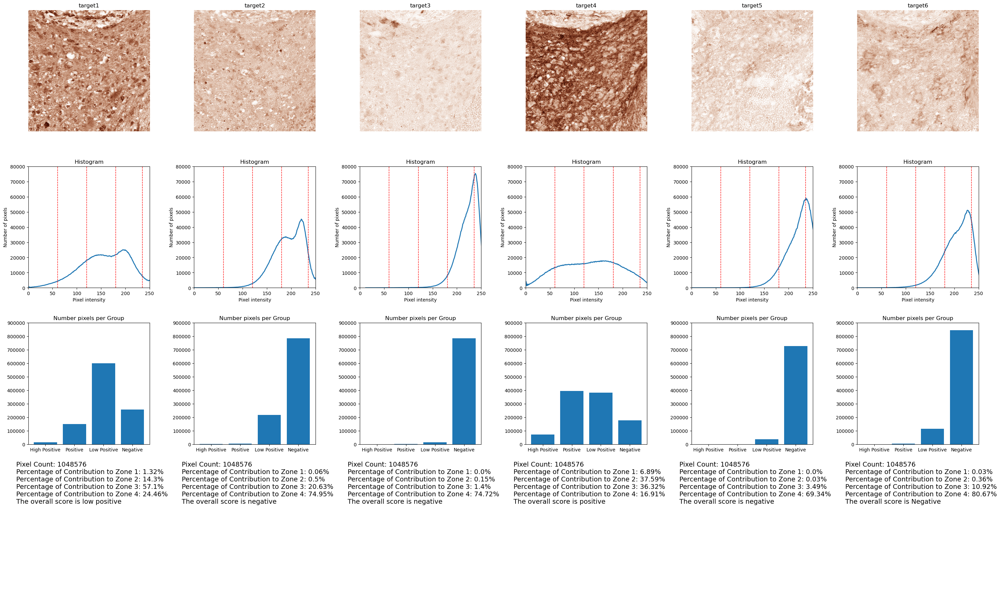

In [20]:
names = ["High Positive", "Positive", "Low Positive", "Negative"]
fig, ax = plt.subplots(4, 6, figsize=(30, 18))
ax[0][0].imshow(images[0])
ax[0][0].set_title("target1")
ax[0][0].axis("off")
ax[1][0].plot(hist_centers_arr[0], hist_arr[0], lw=2)
ax[1][0].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][0].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][0].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][0].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][0].set_ylim(0, 80000)
ax[1][0].set_xlim(0, 250)
ax[1][0].set_title("Histogram")
ax[1][0].set_ylabel("Number of pixels")
ax[1][0].set_xlabel("Pixel intensity")
ax[2][0].bar(names, zones_arr[0][:4])
ax[2][0].set_title("Number pixels per Group")
ax[2][0].set_ylim(0, 900000)
ax[3][0].text(
    -0.1,
    0.8,
    "Pixel Count: "
    + str(count_arr[0])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[0][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[0][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[0][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[0][3], 2))
    + "%\n"
    + "The overall score is low positive",
    fontsize=14,
)
ax[3][0].axis("off")

ax[0][1].imshow(images[1])
ax[0][1].set_title("target2")
ax[0][1].axis("off")
ax[1][1].plot(hist_centers_arr[1], hist_arr[1], lw=2)
ax[1][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][1].set_title("Histogram")
ax[1][1].set_xlim(0, 250)
ax[1][1].set_ylim(0, 80000)
ax[1][1].set_ylabel("Number of pixels")
ax[1][1].set_xlabel("Pixel intensity")
ax[2][1].bar(names, zones_arr[1][:4])
ax[2][1].set_title("Number pixels per Group")
ax[2][1].set_ylim(0, 900000)
ax[3][1].text(
    -0.1,
    0.8,
    "Pixel Count: "
    + str(count_arr[1])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[1][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[1][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[1][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[1][3], 2))
    + "%\n"
    + "The overall score is negative",
    fontsize=14,
)
ax[3][1].axis("off")

ax[0][2].imshow(images[2])
ax[0][2].set_title("target3")
ax[0][2].axis("off")
ax[1][2].plot(hist_centers_arr[2], hist_arr[2], lw=2)
ax[1][2].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][2].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][2].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][2].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][2].set_title("Histogram")
ax[1][2].set_xlim(0, 250)
ax[1][2].set_ylim(0, 80000)
ax[1][2].set_ylabel("Number of pixels")
ax[1][2].set_xlabel("Pixel intensity")
ax[2][2].bar(names, zones_arr[2][:4])
ax[2][2].set_title("Number pixels per Group")
ax[2][2].set_ylim(0, 900000)
ax[3][2].text(
    -0.1,
    0.8,
    "Pixel Count: "
    + str(count_arr[0])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[2][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[2][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[2][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[2][3], 2))
    + "%\n"
    + "The overall score is negative",
    fontsize=14,
)
ax[3][2].axis("off")

ax[0][3].imshow(images[3])
ax[0][3].set_title("target4")
ax[0][3].axis("off")
ax[1][3].plot(hist_centers_arr[3], hist_arr[3], lw=2)
ax[1][3].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][3].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][3].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][3].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][3].set_title("Histogram")
ax[1][3].set_xlim(0, 250)
ax[1][3].set_ylim(0, 80000)
ax[1][3].set_ylabel("Number of pixels")
ax[1][3].set_xlabel("Pixel intensity")
ax[2][3].bar(names, zones_arr[3][:4])
ax[2][3].set_title("Number pixels per Group")
ax[2][3].set_ylim(0, 900000)
ax[3][3].text(
    -0.1,
    0.8,
    "Pixel Count: "
    + str(count_arr[3])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[3][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[3][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[3][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[3][3], 2))
    + "%\n"
    + "The overall score is positive",
    fontsize=14,
)
ax[3][3].axis("off")

ax[0][4].imshow(images[4])
ax[0][4].set_title("target5")
ax[0][4].axis("off")
ax[1][4].plot(hist_centers_arr[4], hist_arr[4], lw=2)
ax[1][4].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][4].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][4].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][4].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][4].set_title("Histogram")
ax[1][4].set_xlim(0, 250)
ax[1][4].set_ylim(0, 80000)
ax[1][4].set_ylabel("Number of pixels")
ax[1][4].set_xlabel("Pixel intensity")
ax[2][4].bar(names, zones_arr[4][:4])
ax[2][4].set_title("Number pixels per Group")
ax[2][4].set_ylim(0, 900000)
ax[3][4].text(
    -0.1,
    0.8,
    "Pixel Count: "
    + str(count_arr[4])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[4][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[4][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[4][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[4][3], 2))
    + "%\n"
    + "The overall score is negative",
    fontsize=14,
)
ax[3][4].axis("off")

ax[0][5].imshow(images[5])
ax[0][5].set_title("target6")
ax[0][5].axis("off")
ax[1][5].plot(hist_centers_arr[5], hist_arr[5], lw=2)
ax[1][5].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][5].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][5].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][5].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][5].set_title("Histogram")
ax[1][5].set_xlim(0, 250)
ax[1][5].set_ylim(0, 80000)
ax[1][5].set_ylabel("Number of pixels")
ax[1][5].set_xlabel("Pixel intensity")
ax[2][5].bar(names, zones_arr[5][:4])
ax[2][5].set_title("Number pixels per Group")
ax[2][5].set_ylim(0, 900000)
ax[3][5].text(
    -0.1,
    0.8,
    "Pixel Count: "
    + str(count_arr[5])
    + "\n"
    + "Percentage of Contribution to Zone 1: "
    + str(round(percentage_arr[5][0], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 2: "
    + str(round(percentage_arr[5][1], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 3: "
    + str(round(percentage_arr[5][2], 2))
    + "%\n"
    + "Percentage of Contribution to Zone 4: "
    + str(round(percentage_arr[5][3], 2))
    + "%\n"
    + "The overall score is Negative",
    fontsize=14,
)
ax[3][5].axis("off")

fig.tight_layout()
plt.show()

C:\Users\mlnot\AppData\Local\Temp\ipykernel_9048\2411257538.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[2][0].set_xticklabels(names, rotation=45, fontsize=20)
C:\Users\mlnot\AppData\Local\Temp\ipykernel_9048\2411257538.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[2][1].set_xticklabels(names, rotation=45, fontsize=20)
C:\Users\mlnot\AppData\Local\Temp\ipykernel_9048\2411257538.py:99: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[2][2].set_xticklabels(names, rotation=45, fontsize=20)
C:\Users\mlnot\AppData\Local\Temp\ipykernel_9048\2411257538.py:127: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


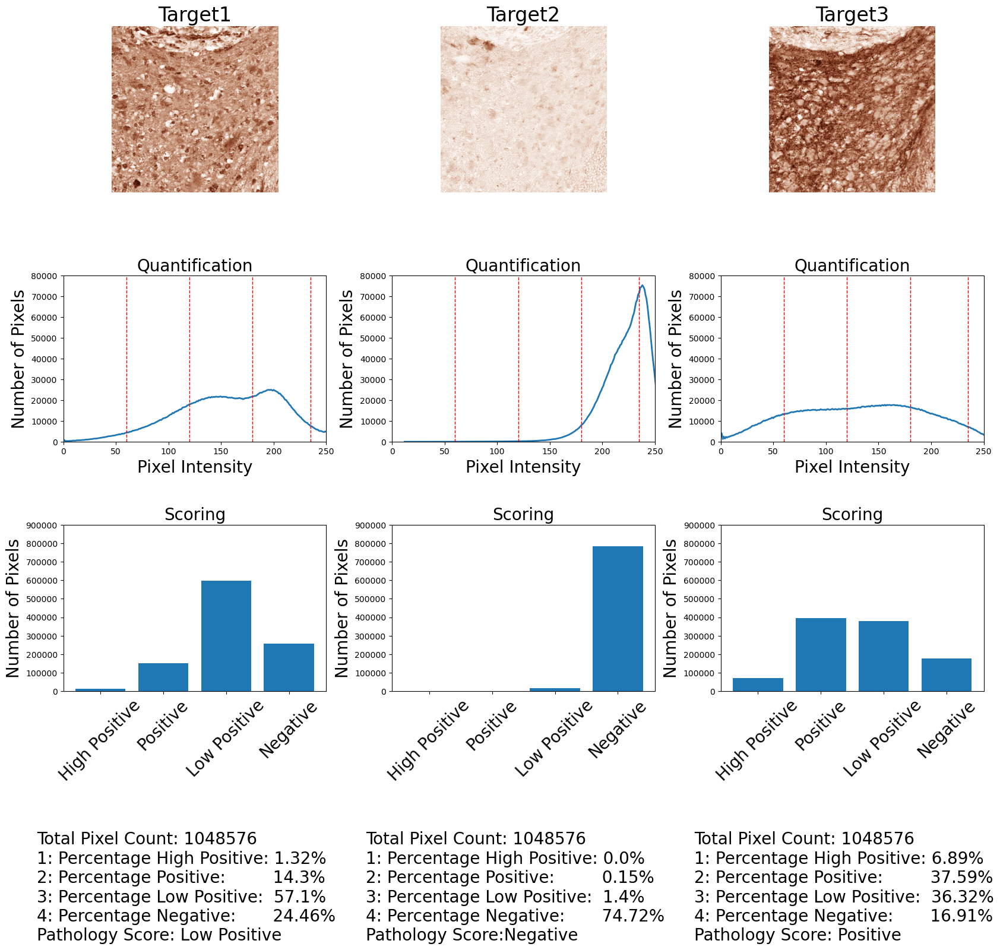

In [128]:
names = ["High Positive", "Positive", "Low Positive", "Negative"]
fig, ax = plt.subplots(
    4, 3, figsize=(20, 20), gridspec_kw={"hspace": 0.5, "wspace": 0.25}
)
ax[0][0].imshow(images[0])
ax[0][0].set_title("Target1", fontsize=24)
ax[0][0].axis("off")
ax[1][0].plot(hist_centers_arr[0], hist_arr[0], lw=2)
ax[1][0].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][0].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][0].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][0].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][0].set_ylim(0, 80000)
ax[1][0].set_xlim(0, 250)
ax[1][0].set_title("Quantification", fontsize=20)
ax[1][0].set_ylabel("Number of Pixels", fontsize=20)
ax[1][0].set_xlabel("Pixel Intensity", fontsize=20)
ax[2][0].bar(names, zones_arr[0][:4])
ax[2][0].set_xticklabels(names, rotation=45, fontsize=20)
ax[2][0].set_ylabel("Number of Pixels", fontsize=20)
ax[2][0].set_title("Scoring", fontsize=20)
ax[2][0].set_ylim(0, 900000)
ax[3][0].text(
    -0.1,
    0,
    "Total Pixel Count: "
    + str(count_arr[0])
    + "\n"
    + "1: Percentage High Positive: "
    + str(round(percentage_arr[0][0], 2))
    + "%\n"
    + "2: Percentage Positive:         "
    + str(round(percentage_arr[0][1], 2))
    + "%\n"
    + "3: Percentage Low Positive:  "
    + str(round(percentage_arr[0][2], 2))
    + "%\n"
    + "4: Percentage Negative:       "
    + str(round(percentage_arr[0][3], 2))
    + "%\n"
    + "Pathology Score: Low Positive",
    fontsize=20,
)
ax[3][0].axis("off")

ax[0][1].imshow(images[2])
ax[0][1].set_title("Target2", fontsize=24)
ax[0][1].axis("off")
ax[1][1].plot(hist_centers_arr[2], hist_arr[2], lw=2)
ax[1][1].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][1].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][1].set_title("Quantification", fontsize=20)
ax[1][1].set_xlim(0, 250)
ax[1][1].set_ylim(0, 80000)
ax[1][1].set_ylabel("Number of Pixels", fontsize=20)
ax[2][1].set_ylabel("Number of Pixels", fontsize=20)
ax[1][1].set_xlabel("Pixel Intensity", fontsize=20)
ax[2][1].bar(names, zones_arr[2][:4])
ax[2][1].set_xticklabels(names, rotation=45, fontsize=20)
ax[2][1].set_title("Scoring", fontsize=20)
ax[2][1].set_ylim(0, 900000)
ax[3][1].text(
    -0.1,
    0,
    "Total Pixel Count: "
    + str(count_arr[2])
    + "\n"
    + "1: Percentage High Positive: "
    + str(round(percentage_arr[2][0], 2))
    + "%\n"
    + "2: Percentage Positive:         "
    + str(round(percentage_arr[2][1], 2))
    + "%\n"
    + "3: Percentage Low Positive:  "
    + str(round(percentage_arr[2][2], 2))
    + "%\n"
    + "4: Percentage Negative:       "
    + str(round(percentage_arr[2][3], 2))
    + "%\n"
    + "Pathology Score:Negative",
    fontsize=20,
)
ax[3][1].axis("off")

ax[0][2].imshow(images[3])
ax[0][2].set_title("Target3", fontsize=24)
ax[0][2].axis("off")
ax[1][2].plot(hist_centers_arr[3], hist_arr[3], lw=2)
ax[1][2].axvline(x=60, color="r", linestyle="dashed", linewidth=1)
ax[1][2].axvline(x=120, color="r", linestyle="dashed", linewidth=1)
ax[1][2].axvline(x=180, color="r", linestyle="dashed", linewidth=1)
ax[1][2].axvline(x=235, color="r", linestyle="dashed", linewidth=1)
ax[1][2].set_title("Quantification", fontsize=20)
ax[1][2].set_xlim(0, 250)
ax[1][2].set_ylim(0, 80000)
ax[1][2].set_ylabel("Number of Pixels", fontsize=20)
ax[1][2].set_xlabel("Pixel Intensity", fontsize=20)
ax[2][2].bar(names, zones_arr[3][:4])
ax[2][2].set_xticklabels(names, rotation=45, fontsize=20)

ax[2][2].set_ylabel("Number of Pixels", fontsize=20)
ax[2][2].set_title("Scoring", fontsize=20)
ax[2][2].set_ylim(0, 900000)
ax[3][2].text(
    -0.1,
    0,
    "Total Pixel Count: "
    + str(count_arr[3])
    + "\n"
    + "1: Percentage High Positive: "  # 15
    + str(round(percentage_arr[3][0], 2))
    + "%\n"
    + "2: Percentage Positive:         "  # 10
    + str(round(percentage_arr[3][1], 2))
    + "%\n"
    + "3: Percentage Low Positive:  "  # 14
    + str(round(percentage_arr[3][2], 2))
    + "%\n"
    + "4: Percentage Negative:       "  # 10
    + str(round(percentage_arr[3][3], 2))
    + "%\n"
    + "Pathology Score: Positive",
    fontsize=20,
)
ax[3][2].axis("off")

fig.tight_layout()
plt.show()

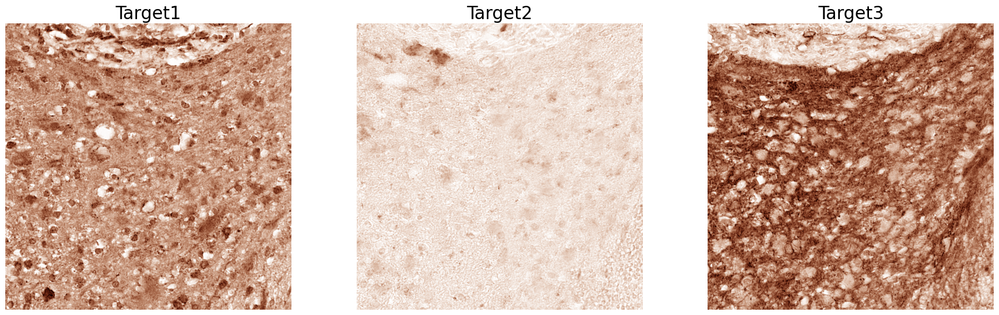

In [116]:
names = ["High Positive", "Positive", "Low Positive", "Negative"]
fig, ax = plt.subplots(1, 3, figsize=(20, 6))
ax[0].imshow(images[0])
ax[0].set_title("Target1", fontsize=24)
ax[0].axis("off")
ax[1].imshow(images[2])
ax[1].set_title("Target2", fontsize=24)
ax[1].axis("off")
ax[2].imshow(images[3])
ax[2].set_title("Target3", fontsize=24)
ax[2].axis("off")
plt.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(20, 6))

In [9]:
image = images[0]
image = img_as_ubyte(image)
gray_scale = color.rgb2gray(image)
gray_scale_ubyte = img_as_ubyte(gray_scale)

h, w = gray_scale_ubyte.shape
postive_px = np.empty(shape=gray_scale_ubyte.shape)

for y in range(h):
    for x in range(w):
        if gray_scale_ubyte[x, y] < 121:
            postive_px[x, y] = gray_scale_ubyte[x, y]

In [10]:
image1 = images[2]
image1 = img_as_ubyte(image1)
gray_scale1 = color.rgb2gray(image1)
gray_scale_ubyte1 = img_as_ubyte(gray_scale1)

h, w = gray_scale_ubyte1.shape
postive_px1 = np.empty(shape=gray_scale_ubyte1.shape)

for y in range(h):
    for x in range(w):
        if gray_scale_ubyte1[x, y] < 121:
            postive_px1[x, y] = gray_scale_ubyte1[x, y]

In [11]:
output = np.zeros(gray_scale_ubyte.shape)
count = 0
for y in range(h):
    for x in range(w):
        if (postive_px[x, y] or postive_px1[x, y]) != 0:
            output[x, y] = 0
            count += 1
avg_white = np.mean((zones_arr[0][4], zones_arr[2][4]))
count_minus_white = postive_px.size - avg_white
print("Percentage positive", ((count / count_minus_white) * 100), "%")

Percentage positive 77.26085503377304 %


In [8]:
images_gray = [
    io.imread(file, as_gray=True)
    for file in glob.glob(
        r"C:\Users\mlnot\Desktop\Images\saved _tiles\for display\Images\20_73/*.tif"
    )
]

In [11]:
h, w = gray_scale_ubyte.shape
output = np.zeros(gray_scale_ubyte.shape)
count = 0
zones_arr = np.array(zones_arr)
total_px = gray_scale_ubyte.size
images_gray = np.array(images_gray)
images_postive_px = np.zeros((images_gray.__len__(), h, w))
images_ubyte = np.empty_like(images_gray)
for i in range(images_gray.__len__()):
    images_ubyte[i] = img_as_ubyte(images_gray[i])


for y in range(h):
    for x in range(w):
        if any(img[x, y] < 121 for img in images_ubyte):
            output[x, y] = 1
            count += 1

avg_white = zones_arr[:, 4].mean()
count_minus_white = total_px - avg_white
print("Percentage positive", ((count / count_minus_white) * 100), "%")

Percentage positive 91.47042216759395 %


In [6]:
h, w = gray_scale_ubyte.shape
output = np.zeros(gray_scale_ubyte.shape)
count = 0
for i in range(images.__len__()):
    img_gray = color.rgb2gray(images[i])
    img_ubyte = img_as_ubyte(img_gray)
    for y in range(h):
        for x in range(w):
            if not (output[x, y]):
                if img_ubyte[x, y] < 121:
                    output[x, y] = 1
                    count += 1
zones_arr = np.array(zones_arr)
avg_white = zones_arr[:, 4].mean()
count_minus_white = gray_scale_ubyte.size - avg_white
print("Percentage positive", (round((count / count_minus_white) * 100, 2)), "%")

NameError: name 'gray_scale_ubyte' is not defined

In [5]:
h, w = gray_scale_ubyte.shape
positives_images = np.zeros((images.__len__(), h, w))
output = np.zeros((h, w))
# images_ubyte = np.empty_like(images)
c = 0
for i in range(images.__len__()):
    image_grayscale = color.rgb2gray(images[i])
    image_ubyte = img_as_ubyte(image_grayscale)
    for y in range(h):
        for x in range(w):
            if image_ubyte[x, y] < 121:
                positives_images[i, x, y] = image_ubyte[x, y]
                if not output[x, y]:
                    output[x, y] = 1
                    c += 1


avg_white = zones_arr[:, 4].mean()
count_minus_white = gray_scale_ubyte.size - avg_white
print("Percentage positive", (round((c / count_minus_white) * 100, 2)), "%")

NameError: name 'gray_scale_ubyte' is not defined

In [3]:
comparison = [2, np.zeros((2, 1024, 1024, 3))]
img1 = images[0]
img2 = images[2]
comparison[0] = img1
comparison[1] = img2
(
    output,
    perc_pos,
    positive_img,
    overlap,
    nonoverlap,
    neither,
) = h.compute_antigen_colocalization(comparison)

print("Percentage positive", perc_pos, "%")
print("overlap", overlap, "%")
print("non overlap", nonoverlap, "%")
print("neither", neither, "%")

c:\Users\mlnot\anaconda3\envs\DoctorThesis\Lib\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)
100%|██████████| 1024/1024 [00:03<00:00, 302.52it/s]


Percentage positive 77.58 %
overlap 19.9042 %
non overlap 51.5237 %
neither 28.5721 %


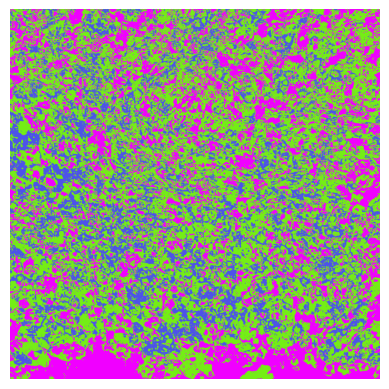

[[[240.   0. 255.]
  [240.   0. 255.]
  [240.   0. 255.]
  ...
  [116. 238.  21.]
  [116. 238.  21.]
  [116. 238.  21.]]

 [[116. 238.  21.]
  [240.   0. 255.]
  [240.   0. 255.]
  ...
  [116. 238.  21.]
  [116. 238.  21.]
  [116. 238.  21.]]

 [[116. 238.  21.]
  [116. 238.  21.]
  [240.   0. 255.]
  ...
  [116. 238.  21.]
  [116. 238.  21.]
  [116. 238.  21.]]

 ...

 [[240.   0. 255.]
  [240.   0. 255.]
  [116. 238.  21.]
  ...
  [240.   0. 255.]
  [240.   0. 255.]
  [240.   0. 255.]]

 [[240.   0. 255.]
  [116. 238.  21.]
  [116. 238.  21.]
  ...
  [240.   0. 255.]
  [240.   0. 255.]
  [240.   0. 255.]]

 [[116. 238.  21.]
  [116. 238.  21.]
  [116. 238.  21.]
  ...
  [240.   0. 255.]
  [240.   0. 255.]
  [240.   0. 255.]]]


In [4]:
plt.imshow(positive_img.astype(np.uint8))
plt.axis("off")
plt.show()
print(positive_img)

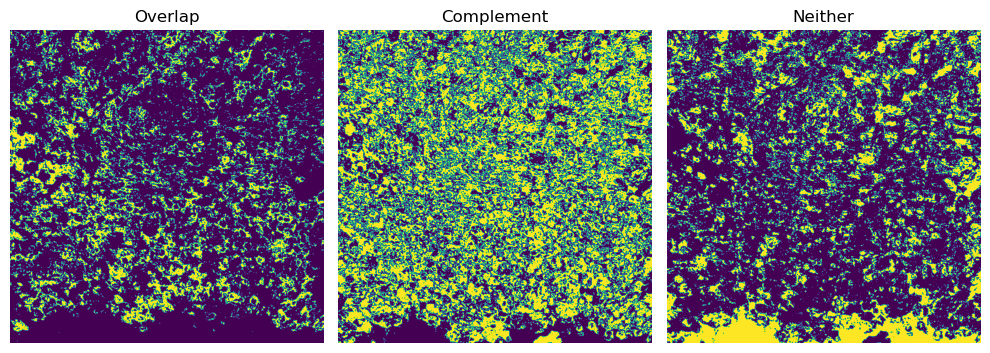

In [9]:
fig, ax = plt.(1,3,figsize= (10,30))
ax[0].imshow(positive_img[0])
ax[1].imshow(positive_img[1])
ax[2].imshow(positive_img[2])
ax[0].axis('off')
ax[1].axis('off')
ax[2].axis('off')
ax[0].set_title('Overlap')
ax[1].set_title('Complement')
ax[2].set_title('Neither')
fig.tight_layout()
plt.show()

In [38]:
# testing Data from paper whether it makes sense
# perc = [312405,1676079,1541200,1420122]


perc = [67935, 1047301, 1752445, 2090140]


score = np.zeros(4)


for i in range(4):
    score[i] = (perc[i] * (4 - i)) / 4958816
print(score)

[0.05479937 0.63359943 0.70679977 0.42149981]


In [3]:
overlap_img = np.zeros((3, 1024, 1024))

In [51]:
img = io.imread(r"C:\Users\mlnot\Desktop\SAIL\Neuer Ordner\25_85_DABadam.tif")
(
    hist,
    hist_centers,
    zones,
    percentage,
    score,
    pixelcount,
    positive_px,
) = h.calculate_pixel_intensity(img)

In [ ]:
test = np.full((1024, 1024), 255)

In [52]:
img1 = io.imread(r"C:\Users\mlnot\Desktop\SAIL\Neuer Ordner\25_85_DABpdpn.tif")
(
    hist,
    hist_centers,
    zones,
    percentage,
    score,
    pixelcount,
    positive_px1,
) = h.calculate_pixel_intensity(img1)

In [53]:
images = np.zeros((2, 1024, 1024))
images[0] = positive_px
images[1] = positive_px1
overlap_img, overlap, non_overlap, neither = h.calculate_overlap(images)

In [46]:
print(overlap)
print(non_overlap)
print(neither)

7.8012
50.5875
41.6113


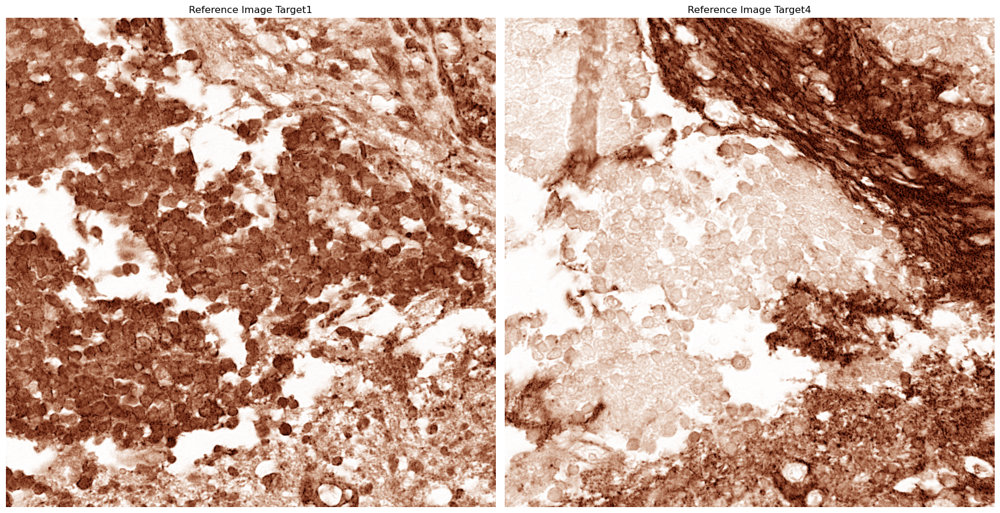

In [79]:
fig, ax = plt.subplots(1, 2, figsize=(17, 30))
ax[0].imshow(img.astype(np.uint8))
ax[1].imshow(img1.astype(np.uint8))
ax[0].set_title("Reference Image Target1")
ax[1].set_title("Reference Image Target3")
ax[0].axis("off")
ax[1].axis("off")
plt.tight_layout()
plt.show()

In [132]:
Image.fromarray(positive_px).save(
    r"C:\Users\mlnot\Desktop\SAIL\Colocalization\positive_px.tif"
)

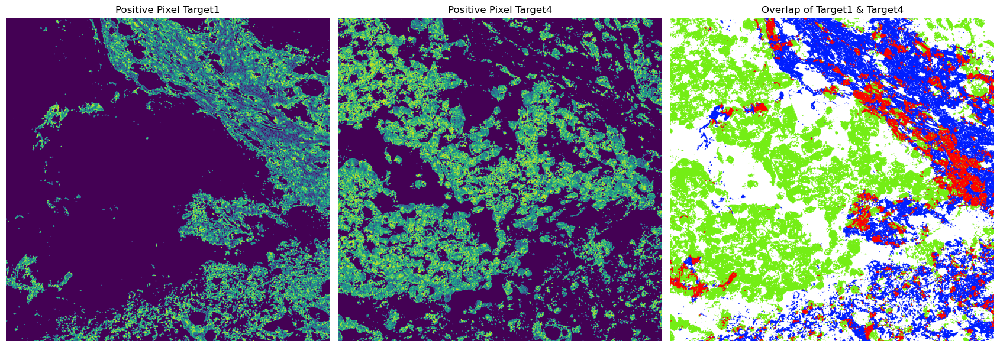

In [78]:
fig, ax = plt.subplots(1, 3, figsize=(17, 30))
ax[0].imshow(positive_px1.astype())
ax[1].imshow(positive_px.astype(np.uint8))
ax[2].imshow(overlap_img.astype(np.uint8))
ax[0].axis("off")
ax[1].axis("off")
ax[2].axis("off")
ax[0].set_title("Positive Pixel Target1")
ax[1].set_title("Positive Pixel Target3")
ax[2].set_title("Overlap of Target1 & Target3")
ax[2].set_xlabel(
    " blue: poitive pixels in target1,\n blue positive pixels in target3, \n red: positive pixels in both targets"
)
fig.tight_layout()
plt.show()

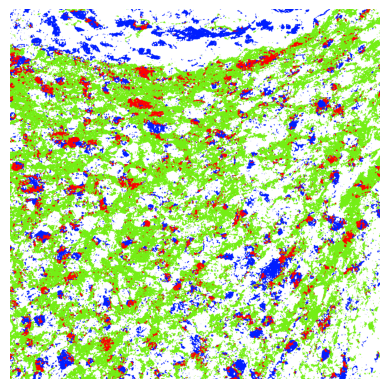

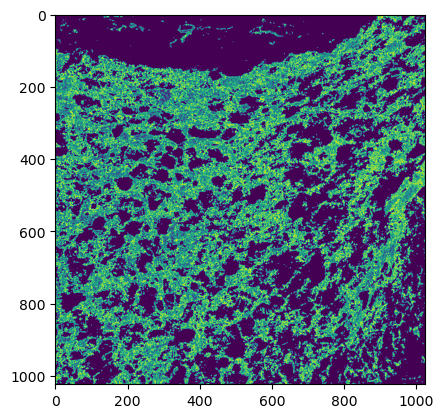

In [6]:
plt.imshow(overlap_img.astype(np.uint8))
plt.axis("off")
plt.show()
plt.imshow(positive_px.astype(np.uint8))

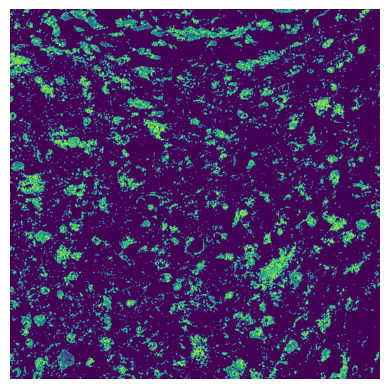

In [7]:
plt.imshow(positive_px1.astype(np.uint8))
plt.axis("off")
plt.show()